### Conteo de Granos, Usando el Paper de Eicken, 1993 y algoritmos de Watershed


In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd 
import cv2 
import ipywidgets as wd

### Original Images

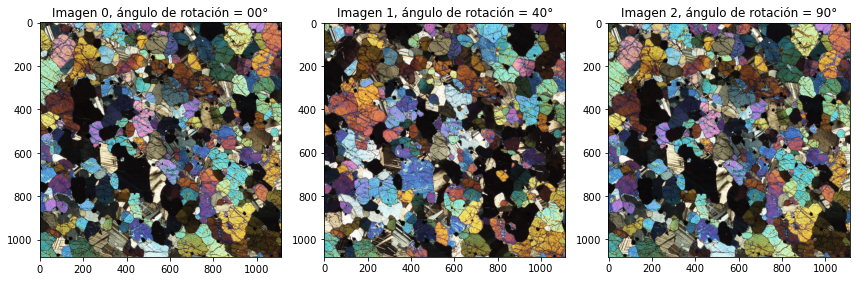

In [2]:
img = cv2.imread('XPL00.jpg',1)
img1 = cv2.imread("XPL40.jpg",1)
img2 = cv2.imread('XPL90.jpg',1)
imgsorg = [img,img1,img2]
angulos = ["00", "40", "90"]
def graphImgsColor(imgs):
    fig, axes = plt.subplots(nrows=1, ncols=len(imgs), figsize=(12,6))
    for i, ax in enumerate(axes):
        ax.imshow(imgs[i])
        ax.set_title(f"Imagen {i}, ángulo de rotación = {angulos[i]}°")
    fig.tight_layout()
graphImgsColor(imgsorg)

### Gray Histograms

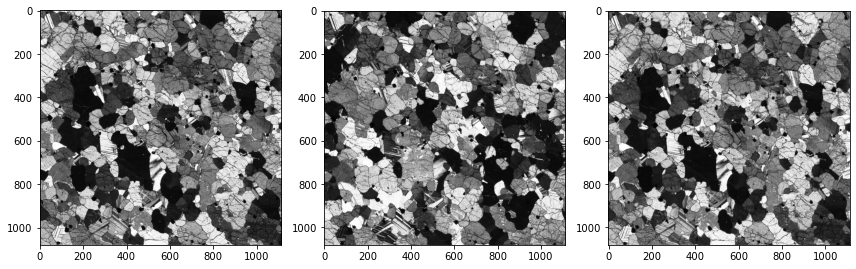

In [3]:
img = cv2.imread('XPL00.jpg',0)
img1 = cv2.imread("XPL40.jpg", 0)
img2 = cv2.imread('XPL90.jpg',0)
imgs = [img,img1,img2]

def graphImgs(imgs, title=None, cmap="Greys_r", figsize=(12,6)):
    """ imgs ->  a list of images
        title ->  a list of strings        
        returns mpl subplots
    """
    fig, axes = plt.subplots(nrows=1, ncols=len(imgs), figsize=figsize)
    for i, ax in enumerate(axes):
        ax.imshow(imgs[i], cmap=cmap)
        if title is not None:
            try:
                ax.set_title(title[i])
            except:
                pass
    fig.tight_layout()

graphImgs(imgs)

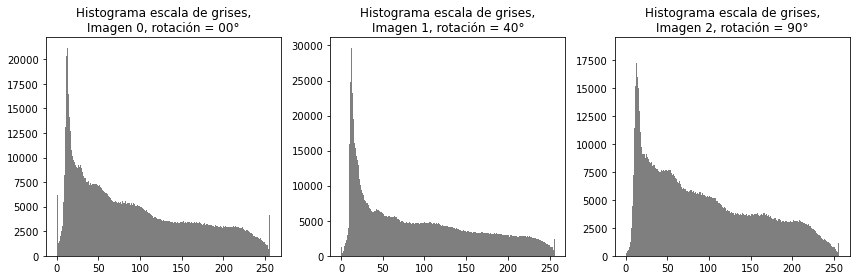

In [4]:
def plotGrayHist(imgs):
    fig, axes = plt.subplots(nrows=1, ncols=len(imgs), figsize=(12,4))
    for i, ax in enumerate(axes):
        ax.hist(imgs[i].ravel(),256,[0,256], color="k", alpha=0.5)
        ax.set_title(f"Histograma escala de grises,\nImagen {i}, rotación = {angulos[i]}°")
    fig.tight_layout()    
plotGrayHist(imgs)

#### Image Enhancing median filter

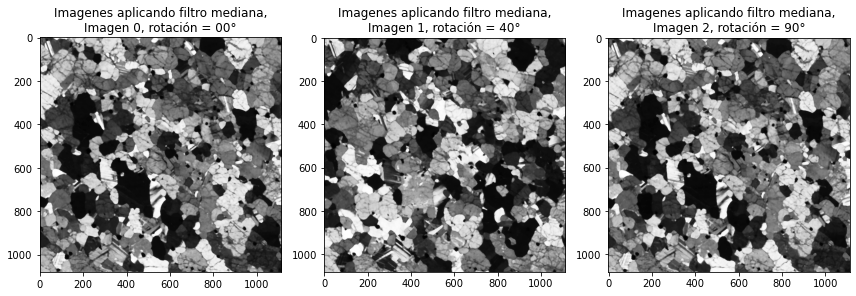

In [5]:
def medianImgs(imgs):
    global imgsMedian 
    imgsMedian =[]
    fig, axes = plt.subplots(nrows=1, ncols=len(imgs), figsize=(12,4))
    for i, ax in enumerate(axes):
        imgMed = cv2.medianBlur(imgs[i], 7)
        ax.imshow(imgMed,  cmap="Greys_r")
        ax.set_title(f"Imagenes aplicando filtro mediana,\nImagen {i}, rotación = {angulos[i]}°")
        imgsMedian.append(imgMed)
    fig.tight_layout()    

medianImgs(imgs)

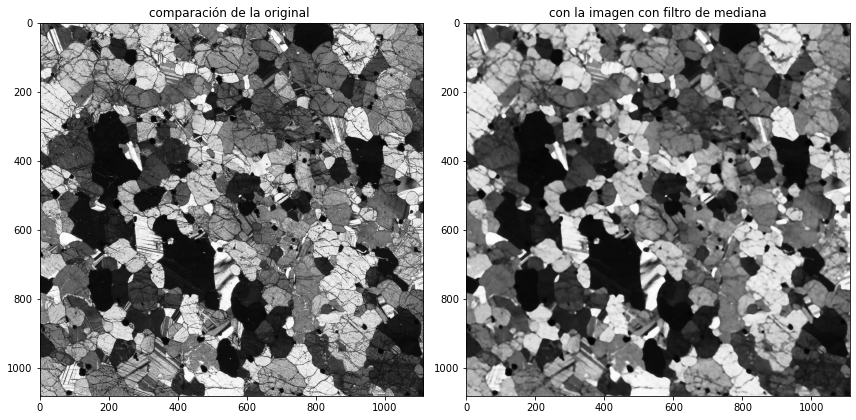

In [6]:
compare_original_median = [imgs[0], imgsMedian[0]]
graphImgs(compare_original_median, ["comparación de la original ","con la imagen con filtro de mediana"])

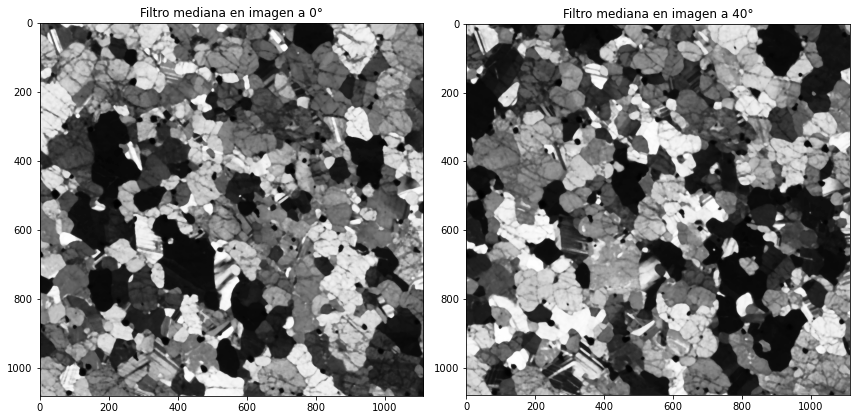

In [7]:
compare = [imgsMedian[0], imgsMedian[1]]
graphImgs(compare, ["Filtro mediana en imagen a 0°", "Filtro mediana en imagen a 40°"])

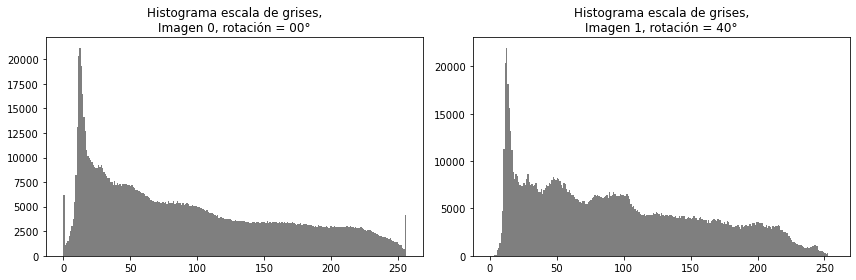

In [8]:
plotGrayHist(compare_original_median)

### Procesos Morfológicos: Erosión y dilatación (opening)
Operations of sequentially dilating and eroding an image

In [9]:

erosionDilationImgs5 = []
for i in imgsMedian:
    kernel = np.ones((3,3), np.uint8)
    eroded = cv2.erode(i, kernel, iterations=10)
    dilated = cv2.dilate(eroded, kernel, iterations=10)
    erosionDilationImgs5.append(dilated)


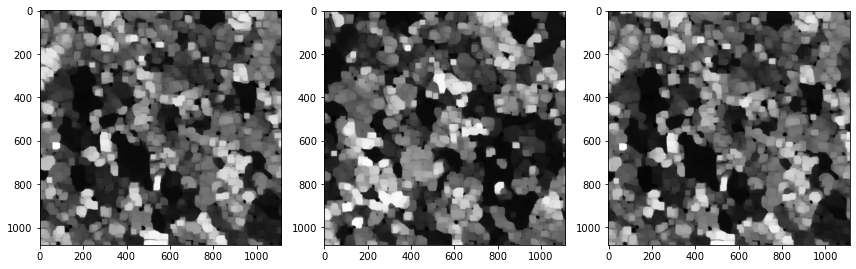

In [10]:
graphImgs(erosionDilationImgs5)

### Filtro paso bajo

In [11]:
pasoBajo = []

for i in erosionDilationImgs5:
    blur = cv2.GaussianBlur(i,(5,5),0)
    pasoBajo.append(blur)

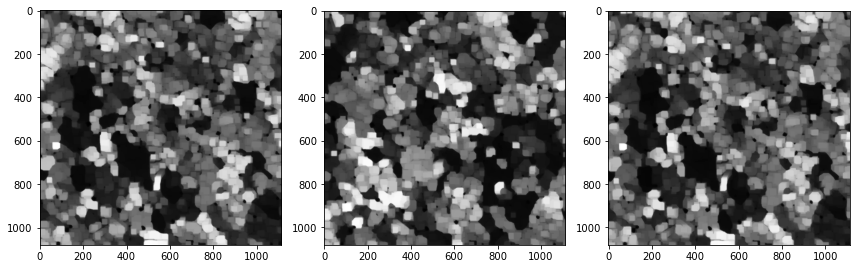

In [12]:
graphImgs((pasoBajo))

### Detección de bordes (Sobel)

In [15]:
def applySobelY(img, ksize):
    sobely = cv2.Sobel(img,cv2.CV_16S, 0, 1,ksize, scale=1, delta=0, borderType =cv2.BORDER_DEFAULT)
    absGradY = cv2.convertScaleAbs(sobely)
    return absGradY

def applySobelX(img, ksize): 
    sobelx = cv2.Sobel(img, cv2.CV_16S, 1, 0, ksize,scale=1, delta=0, borderType =cv2.BORDER_DEFAULT)
    absGradX = cv2.convertScaleAbs(sobelx)
    return absGradX

def applySobel(img, ksize):
    absGrady = applySobelY(img, ksize)
    absGradx = applySobelX(img, ksize)
    grad = cv2.addWeighted(absGradx, 0.5, absGrady, 0.5, 0)
    return grad

sobelImgs = []

for i in compare_original_median:
    i = i[:,:1111]
    sobel = applySobel(i, ksize=10)
    sobelImgs.append(sobel)
    


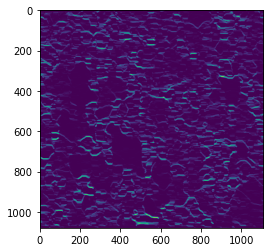

In [16]:
plt.imshow(applySobelY(pasoBajo[0],5))

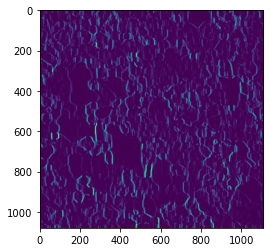

In [17]:
plt.imshow(applySobelX(pasoBajo[0],5))

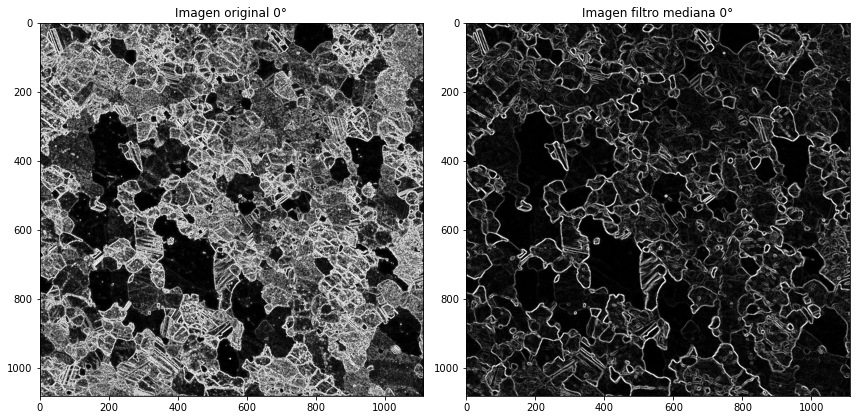

In [18]:
graphImgs(sobelImgs, ["Imagen original 0°", "Imagen filtro mediana 0°"])

In [19]:
sobelPasoBajo = []
for i in pasoBajo:
    j = i[:,:1111]
    sobelBajo = applySobel(j, ksize=5)
    sobelPasoBajo.append(sobelBajo)
    

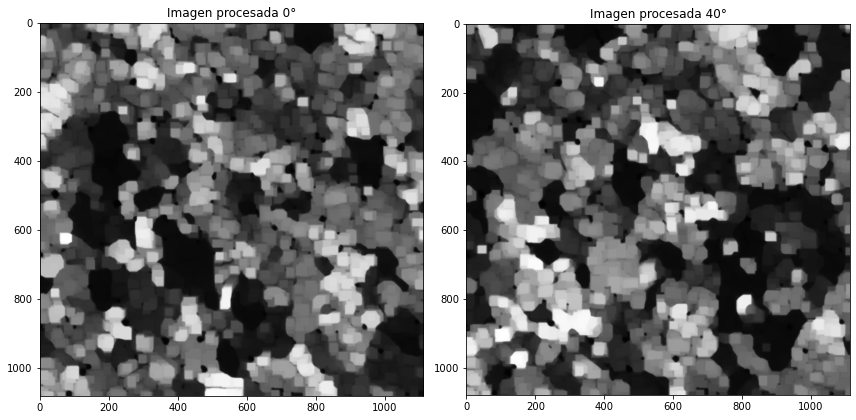

In [20]:
graphImgs(pasoBajo[:2], ["Imagen procesada 0°", "Imagen procesada 40°"])

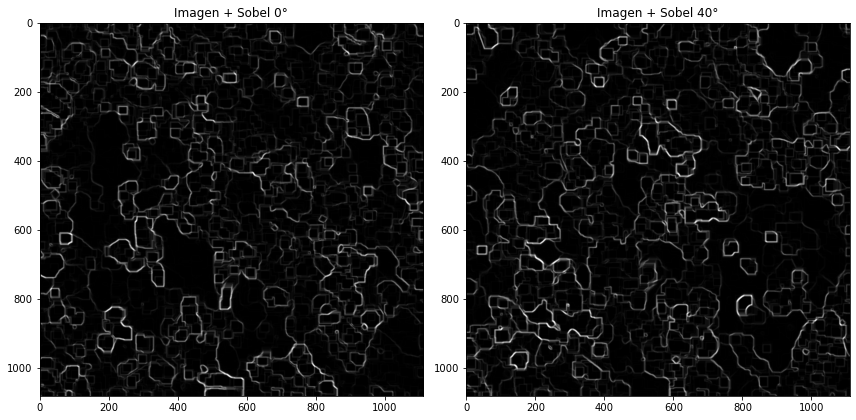

In [21]:
graphImgs(sobelPasoBajo[:2], ["Imagen + Sobel 0°", "Imagen + Sobel 40°"])

### Adición imagenes

#### Sumando

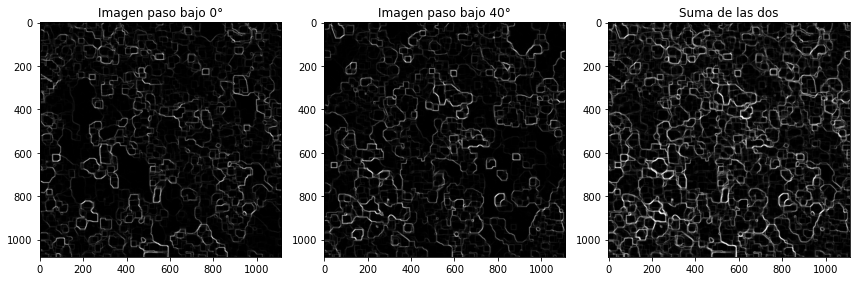

In [134]:
img1 = sobelPasoBajo[0]
img2 = sobelPasoBajo[1]
dstAdd = cv2.add(img1, img2)
graphImgs([img1, img2, dstAdd], title=["Imagen paso bajo 0°", "Imagen paso bajo 40°", "Suma de las dos"], cmap="Greys_r")

#### Operación union de open-cv "Blending"

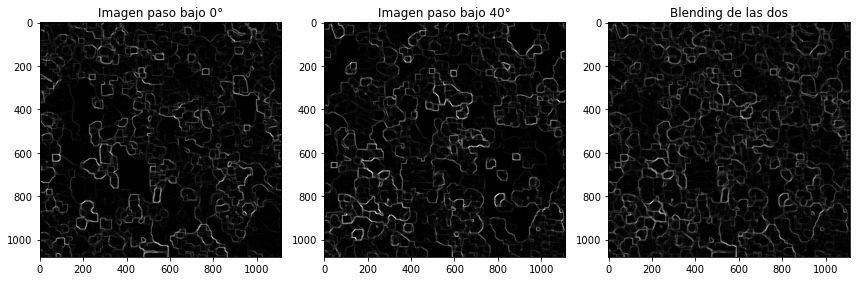

In [23]:
img1 = sobelPasoBajo[0]
img2 = sobelPasoBajo[1]
dstBlend = cv2.addWeighted(img1,0.5,img2,0.5,0)
graphImgs([img1, img2, dstBlend], title=["Imagen paso bajo 0°", "Imagen paso bajo 40°", "Blending de las dos"], cmap="Greys_r")

### Binarización

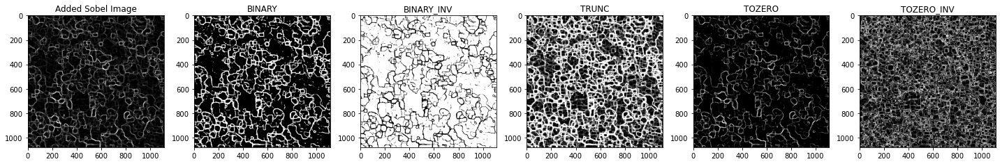

In [79]:
desde = 40


ret,thresh1 = cv2.threshold(dstAdd,desde,255,cv2.THRESH_BINARY)
ret,thresh2 = cv2.threshold(dstAdd,desde,255,cv2.THRESH_BINARY_INV)
ret,thresh3 = cv2.threshold(dstAdd,desde,255,cv2.THRESH_TRUNC)
ret,thresh4 = cv2.threshold(dstAdd,desde,255,cv2.THRESH_TOZERO)
ret,thresh5 = cv2.threshold(dstAdd,desde,255,cv2.THRESH_TOZERO_INV)
titles = ['Added Sobel Image','BINARY','BINARY_INV','TRUNC','TOZERO','TOZERO_INV']
images = [dstAdd, thresh1, thresh2, thresh3, thresh4, thresh5]
graphImgs(images, titles, figsize=(20,5))

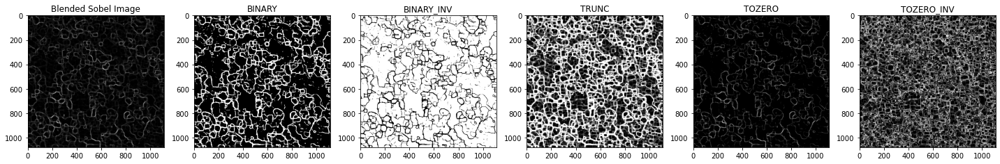

In [25]:
desde = 20


ret,thresh1 = cv2.threshold(dstBlend,desde,255,cv2.THRESH_BINARY)
ret,thresh2 = cv2.threshold(dstBlend,desde,255,cv2.THRESH_BINARY_INV)
ret,thresh3 = cv2.threshold(dstBlend,desde,255,cv2.THRESH_TRUNC)
ret,thresh4 = cv2.threshold(dstBlend,desde,255,cv2.THRESH_TOZERO)
ret,thresh5 = cv2.threshold(dstBlend,desde,255,cv2.THRESH_TOZERO_INV)
titles = ['Blended Sobel Image','BINARY','BINARY_INV','TRUNC','TOZERO','TOZERO_INV']
images = [dstBlend, thresh1, thresh2, thresh3, thresh4, thresh5]
graphImgs(images, titles, figsize=(20,5))

### Exploración interactiva de la binarización con las imagenes Sobel adicionadas

In [26]:
@wd.interact(desde=(0,255,1))

def actualice(desde=40):
    ret,thresh1 = cv2.threshold(dstAdd,desde,255,cv2.THRESH_BINARY)    
    return graphImgs([dstAdd, thresh1], ["Imagen Sobel Adicionada", f"Binarizada {desde}-255"]) # Se recomienda dejar el valor B entre 2 y 3 veces mayor que A



interactive(children=(IntSlider(value=40, description='desde', max=255), Output()), _dom_classes=('widget-inte…

In [186]:
import os
try:
    os.mkdir("binary")
except:
    print("carpeta existe")
    
for i in range(0,250,10):
    ret,thresh1 = cv2.threshold(dstAdd,i,255,cv2.THRESH_BINARY)  
    plt.imsave("binary/"+f"binary-{i}.jpg", thresh1)

carpeta existe


### Probando la binarización con distintos umbrales

In [191]:
import imageio
from IPython import display
images = []

for i in range(0,250,10):
    images.append(imageio.imread("binary/"+"binary-"+str(i)+".jpg"))
imageio.mimsave('gif_binary.gif', images)

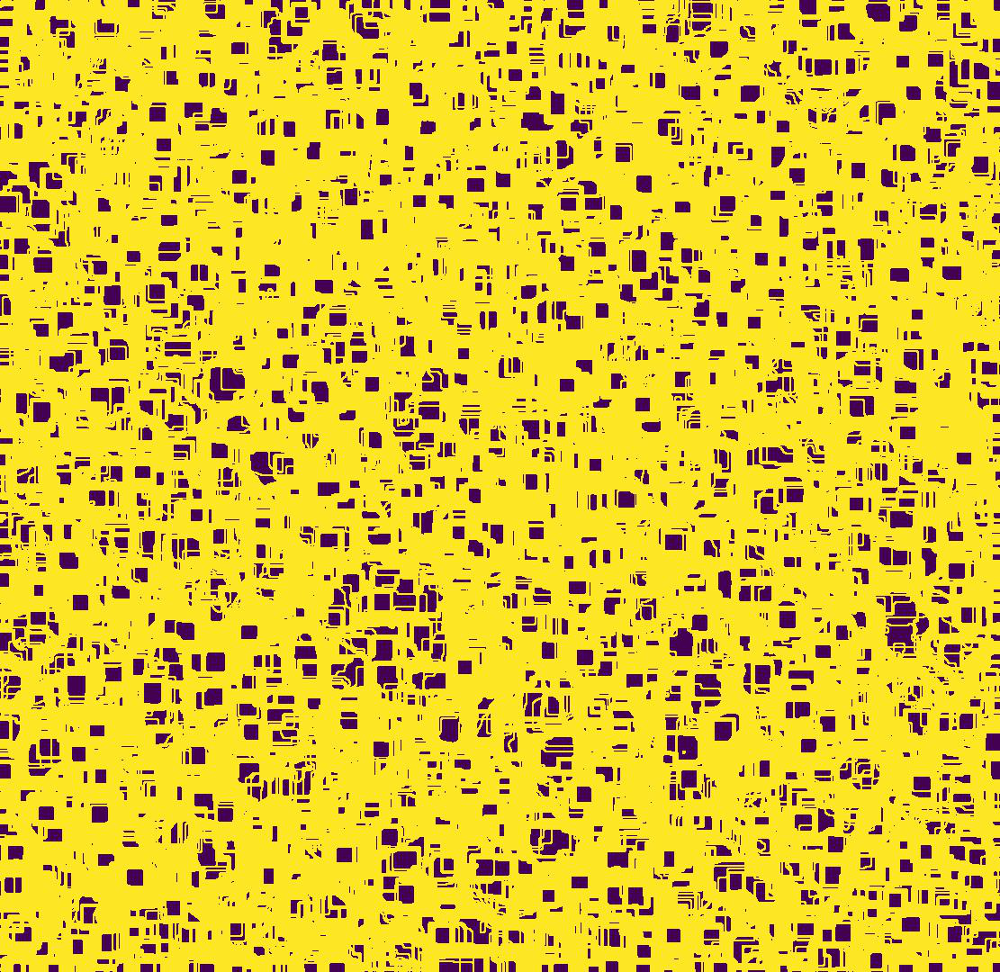

In [192]:
display.Image(filename='gif_binary.gif', width=400, height=400) 

In [185]:
!explorer .

In [143]:
from scipy import ndimage
from skimage import measure, color, io
import cv2
import numpy as np 
import matplotlib.pyplot as plt 
import pandas as pd 
from skimage.segmentation import clear_border


In [172]:
kernel = np.ones((3,3), np.uint8)


ret,thresh1 = cv2.threshold(dstAdd,30,255,cv2.THRESH_BINARY)
eroded = cv2.erode(thresh1, kernel, iterations=0)
dilated = cv2.dilate(eroded, kernel, iterations=0)
dst = cv2.filter2D(dilated,-1,kernel)
blur = cv2.GaussianBlur(dst,(5,5),0)
mask = blur == 0

In [173]:
s = [[1,1,1], [1,1,1], [1,1,1]]

labeled_mask, num_labels = ndimage.label(mask, structure=s)
resultado_final = color.label2rgb(labeled_mask, bg_label=0)

In [174]:
def graphImgsColor(imgs, title=None):
    fig, axes = plt.subplots(nrows=1, ncols=len(imgs), figsize=(12,6))
    for i, ax in enumerate(axes):
        ax.imshow(imgs[i])
        if title is not None:
            try:
                ax.set_title(title[i])
            except:
                pass
    fig.tight_layout()


In [176]:
print(num_labels)

619


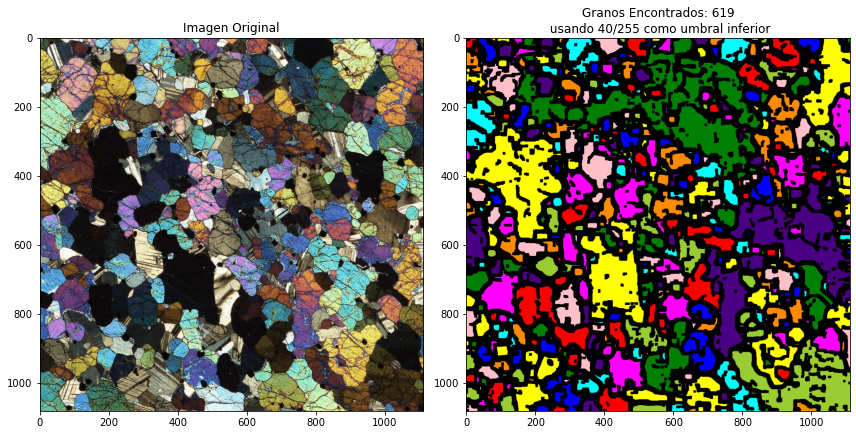

In [180]:
img = cv2.imread('XPL00.jpg',1)
graphImgsColor([img, resultado_final], ["Imagen Original", f"Granos Encontrados: {num_labels}\n usando {desde}/255 como umbral inferior"])